<a href="https://colab.research.google.com/github/anaPK6/Python-Models/blob/main/Multivariate_Gaussian_Distribution.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import plotly.graph_objects as go
from scipy.stats import multivariate_normal

# Mean values of X and Y
mu = np.array([4, 3])

# Covariance matrix
Sigma = np.array([[1, 0], [0, 1]])

# Create a grid of points
x, y = np.mgrid[-3:7:.1, -3:7:.1]
pos = np.dstack((x, y))

# Create the multivariate normal distribution
rv = multivariate_normal(mu, Sigma)

# Create the figure
fig = go.Figure()

# Add the distribution to the figure
z = rv.pdf(pos)
fig.add_trace(go.Surface(x=x, y=y, z=z, colorscale='Viridis', showscale=False))

# Update the layout
fig.update_layout(title='2D Multivariate Gaussian Distribution', autosize=False,
                  width=500, height=500, scene=dict(xaxis_title='X', yaxis_title='Y', zaxis_title='Z'))

# Show the figure
fig.show()

In [ ]:
import numpy as np
import plotly.graph_objects as go
from scipy.stats import multivariate_normal

# Define the mean and covariance for each distribution
parameters = [
    {"mu": np.array([-13, 10]), "Sigma": np.array([[4, 0], [0, 1]])},  # Larger variance in X
    {"mu": np.array([-15, -15]), "Sigma": np.array([[2, 1], [1, 2]])},  # Positive covariance
    {"mu": np.array([5, -5]), "Sigma": np.array([[2, -1], [-1, 2]])}  # Negative covariance
]

# Create a grid of points
x, y = np.mgrid[-20:20:.1, -20:20:.1]
pos = np.dstack((x, y))

# Create the multivariate normal distributions
rvs = [multivariate_normal(p["mu"], p["Sigma"]) for p in parameters]

# Create the figure
fig = go.Figure()

# Add the distributions to the figure
for rv, color in zip(rvs, ['Reds', 'Greens', 'Blues']):
    z = rv.pdf(pos)
    fig.add_trace(go.Surface(x=x, y=y, z=z, colorscale=color, showscale=False))

# Update the layout
fig.update_layout(title='Multivariate Gaussian Distributions', autosize=False,
                  width=700, height=700, scene=dict(xaxis_title='X', yaxis_title='Y', zaxis_title='Z'))

# Show the figure
fig.show()

In [ ]:
import numpy as np
from scipy.stats import multivariate_normal

# Define the mean and covariance for two classes
mean_A = [2, 3]
cov_A = [[1, 0], [0, 1]]

mean_B = [3, 4]
cov_B = [[1, 0], [0, 1]]


### Based on the above data clas has a centre 2,3 and class B ahs a mean at 3,4
### But covariance matrix seem to suggest that there covraince is 0 where as variance of x and Y are each 1



# Generate 10 random samples for each class
samples_A = np.random.multivariate_normal(mean_A, cov_A, 10)
samples_B = np.random.multivariate_normal(mean_B, cov_B, 10)

# Calculate the mean and covariance for each class
mean_A_est = np.mean(samples_A, axis=0)
cov_A_est = np.cov(samples_A, rowvar=False)

mean_B_est = np.mean(samples_B, axis=0)
cov_B_est = np.cov(samples_B, rowvar=False)

# Define a new data point
new_data_point = [2.5, 3.5]

# Calculate the probability of the new data point under each class distribution
prob_A = multivariate_normal.pdf(new_data_point, mean_A_est, cov_A_est)
prob_B = multivariate_normal.pdf(new_data_point, mean_B_est, cov_B_est)

# Classify the new data point based on which class distribution gives higher probability
if prob_A > prob_B:
    print("The new data point is classified as class 'A'")
else:
    print("The new data point is classified as class 'B'")

The new data point is classified as class 'A'


In [ ]:
!pip install --upgrade matplotlib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 16.0 MB/s eta 0:00:00
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.7.1
    Uninstalling matplotlib-3.7.1:
      Successfully uninstalled matplotlib-3.7.1


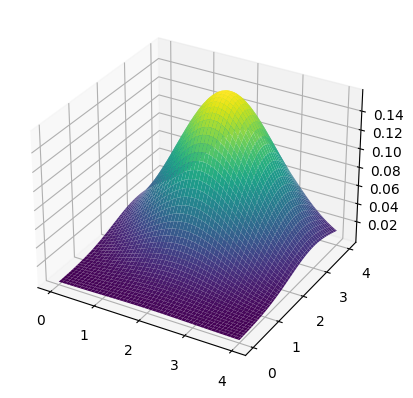

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import multivariate_normal
from mpl_toolkits.mplot3d import Axes3D

# Define the mean and covariance
mean = [2, 3]
cov = [[1, 0], [0, 1]]

# Create a grid of points
x = np.linspace(0, 4, 100)
y = np.linspace(0, 4, 100)
x, y = np.meshgrid(x, y)

# Pack X and Y into a single 3-dimensional array
pos = np.empty(x.shape + (2,))
pos[:, :, 0] = x
pos[:, :, 1] = y

# Create a 3D plot
fig = plt.figure()
ax = fig.add_subplot(projection='3d')  # Changed this line
ax.plot_surface(x, y, multivariate_normal(mean, cov).pdf(pos), cmap='viridis')

plt.show()

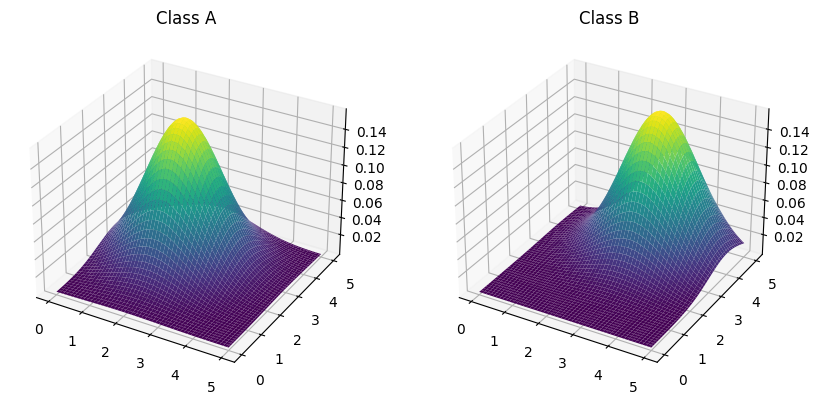

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import multivariate_normal
from mpl_toolkits.mplot3d import Axes3D

# Define the mean and covariance for two classes
mean_A = [2, 3]
cov_A = [[1, 0], [0, 1]]

mean_B = [3, 4]
cov_B = [[1, 0], [0, 1]]

# Create a grid of points
x = np.linspace(0, 5, 100)
y = np.linspace(0, 5, 100)
x, y = np.meshgrid(x, y)

# Pack X and Y into a single 3-dimensional array
pos = np.empty(x.shape + (2,))
pos[:, :, 0] = x
pos[:, :, 1] = y

# Create a 3D plot
fig = plt.figure(figsize=(10, 5))

# Plot class A
ax1 = fig.add_subplot(121, projection='3d')
ax1.plot_surface(x, y, multivariate_normal(mean_A, cov_A).pdf(pos), cmap='viridis')
ax1.set_title("Class A")

# Plot class B
ax2 = fig.add_subplot(122, projection='3d')
ax2.plot_surface(x, y, multivariate_normal(mean_B, cov_B).pdf(pos), cmap='viridis')
ax2.set_title("Class B")

plt.show()

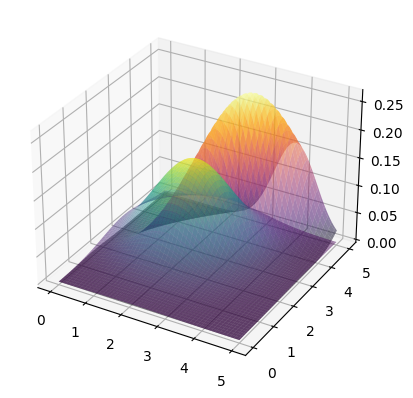

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import multivariate_normal
from mpl_toolkits.mplot3d import Axes3D

# Define the mean and covariance for two classes
mean_A = [2, 3]
cov_A = [[1, 0], [0, 1]]

mean_B = [3, 4]
cov_B = [[1, .8], [.8, 1]]

# Create a grid of points
x = np.linspace(0, 5, 100)
y = np.linspace(0, 5, 100)
x, y = np.meshgrid(x, y)

# Pack X and Y into a single 3-dimensional array
pos = np.empty(x.shape + (2,))
pos[:, :, 0] = x
pos[:, :, 1] = y

# Create a 3D plot
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

# Plot class A
ax.plot_surface(x, y, multivariate_normal(mean_A, cov_A).pdf(pos), cmap='viridis', alpha=0.5)

# Plot class B
ax.plot_surface(x, y, multivariate_normal(mean_B, cov_B).pdf(pos), cmap='inferno', alpha=0.5)

plt.show()

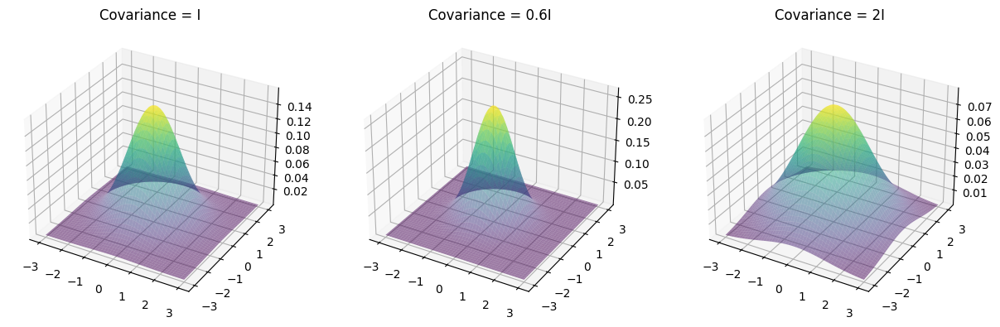

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import multivariate_normal
from mpl_toolkits.mplot3d import Axes3D

# Define the mean and covariance for three cases
mean = [0, 0]
cov_1 = [[1, 0], [0, 1]]  # Identity matrix
cov_2 = [[0.6, 0], [0, 0.6]]  # 0.6 times identity matrix
cov_3 = [[2, 0], [0, 2]]  # 2 times identity matrix

# Create a grid of points
x = np.linspace(-3, 3, 100)
y = np.linspace(-3, 3, 100)
x, y = np.meshgrid(x, y)

# Pack X and Y into a single 3-dimensional array
pos = np.empty(x.shape + (2,))
pos[:, :, 0] = x
pos[:, :, 1] = y

# Create a 3D plot
fig = plt.figure(figsize=(15, 5))

# Plot for cov_1
ax1 = fig.add_subplot(131, projection='3d')
ax1.plot_surface(x, y, multivariate_normal(mean, cov_1).pdf(pos), cmap='viridis', alpha=0.5)
ax1.set_title("Mean =0,Covariance = I")

# Plot for cov_2
ax2 = fig.add_subplot(132, projection='3d')
ax2.plot_surface(x, y, multivariate_normal(mean, cov_2).pdf(pos), cmap='viridis', alpha=0.5)
ax2.set_title("Mean=0, Covariance = 0.6I")

# Plot for cov_3
ax3 = fig.add_subplot(133, projection='3d')
ax3.plot_surface(x, y, multivariate_normal(mean, cov_3).pdf(pos), cmap='viridis', alpha=0.5)
ax3.set_title("Mean=0, Covariance = 2I")

plt.show()

In this code, we first define the mean and covariance for three cases. The mean is a zero vector, and the covariance is an identity matrix, 0.6 times an identity matrix, and 2 times an identity matrix, respectively. We then create a grid of points in the 2-dimensional space and evaluate the probability density function of the multivariate normal distribution at each point on the grid for each case. Finally, we create a single 3D plot and plot all three distributions on it.

As you can see from the plots, as the covariance matrix becomes larger (from I to 2I), the Gaussian distribution becomes more “spread-out”. Conversely, as the covariance matrix becomes smaller (from I to 0.6I), the distribution becomes more “compressed”.